In [1]:
from utils import *
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [5]:
forecast = pd.read_csv("data/fb_prophet_5year_forecast.csv")

cutoff_ts = '2024-05-02'

forecast = forecast[forecast['ds'] >= cutoff_ts]
forecast["timestamp"] = forecast["ds"]

pfc ,arb_free = arbitrage_pipeline_benth(forecast,plot_figure=True,print_arbitrage=True)

Forwards fetched for last available date: 2024-05-02 00:00:00


Arbitrage amount for forward 2024-05-02 00:00:00+02:00 2024-05-03 00:00:00+02:00 : 0.0
Arbitrage amount for forward 2024-05-03 00:00:00+02:00 2024-05-04 00:00:00+02:00 : 0.0
Arbitrage amount for forward 2024-05-04 00:00:00+02:00 2024-05-05 00:00:00+02:00 : 2.842170943040401e-14
Arbitrage amount for forward 2024-05-05 00:00:00+02:00 2024-05-06 00:00:00+02:00 : 7.815970093361102e-14
Arbitrage amount for forward 2024-05-06 00:00:00+02:00 2024-05-07 00:00:00+02:00 : 8.526512829121202e-13
Arbitrage amount for forward 2024-05-06 00:00:00+02:00 2024-05-13 00:00:00+02:00 : 2.7000623958883807e-13
Arbitrage amount for forward 2024-05-07 00:00:00+02:00 2024-05-08 00:00:00+02:00 : 3.282707439211663e-12
Arbitrage amount for forward 2024-05-08 00:00:00+02:00 2024-05-09 00:00:00+02:00 : 2.6716406864579767e-12
Arbitrage amount for forward 2024-05-11 00:00:00+02:00 2024-05-13 00:00:00+02:00 : 5.471179065352771e-13
Arbitrage amount for forward 2024-05-13 00:00:00+02:00 2024-05-20 00:00:00+02:00 : 5.9685

In [9]:
# Fetch forwards data for the same date range as the forecast
forwards = filter_independent(get_forwards(
    timestamp=cutoff_ts,
    start=forecast["timestamp"].min(),
    end=forecast["timestamp"].max()
))

In [25]:
t, F = partition_forwards(forwards, pd.to_datetime(cutoff_ts, utc=True)-pd.Timedelta(hours=2))

In [26]:
# Construct matrices
H = construct_H(t)

In [27]:
s_t = np.array(forecast["yhat"])
A, b = construct_A_and_b(t, F, s_t)


In [28]:
# Solve the system
x, lam = solve_linear_system(H, A, b)

# Results
print("Solution x:", x)

A@x - b

Solution x: [-8.36277834e-06 -6.26556420e-16  5.80091530e-15  2.46814808e+00
 -6.62942810e+01  1.54737684e-05 -2.28830849e-03  8.23791056e-02
  1.15008239e+00 -5.83858869e+01 -9.88567672e-07  8.72460042e-04
 -1.45196229e-01  8.43249308e+00 -1.45774815e+02 -1.69076316e-05
  5.45715045e-03 -6.40342792e-01  3.21995281e+01 -5.73581446e+02
  2.16845978e-05 -9.36226562e-03  1.49365312e+00 -1.04376210e+02
  2.70423628e+03 -1.75650452e-05  9.47756298e-03 -1.89751603e+00
  1.66917322e+02 -5.43456968e+03  7.44852057e-06 -4.93025088e-03
  1.21457177e+00 -1.31843107e+02  5.32080574e+03 -6.42459436e-08
  1.18328220e-04 -5.76701660e-02  1.06479898e+01 -6.63820316e+02
 -4.65716076e-07  4.65198414e-04 -1.70056109e-01  2.68315656e+01
 -1.53773341e+03  5.11536212e-08 -8.06159862e-05  4.60863935e-02
 -1.12095148e+01  9.72977900e+02 -1.43972579e-08  3.26559329e-05
 -2.73138101e-02  9.92974380e+00 -1.31006203e+03  3.03140676e-09
 -9.17286208e-06  1.03321051e-02 -5.12862216e+00  9.48692845e+02
  2.96546671e

array([ 0.00000000e+00,  5.68434189e-14,  0.00000000e+00, -1.81898940e-12,
        0.00000000e+00,  1.81898940e-11,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00, -1.81898940e-12,  3.63797881e-12,
        0.00000000e+00,  1.70530257e-13,  0.00000000e+00,  2.72848411e-12,
        3.63797881e-12,  0.00000000e+00,  0.00000000e+00, -5.82076609e-11,
       -1.16415322e-10, -1.45519152e-10,  1.16415322e-10, -2.91038305e-11,
        1.45519152e-11,  0.00000000e+00,  0.00000000e+00,  5.82076609e-11,
       -1.45519152e-10,  0.00000000e+00,  1.45519152e-11,  7.46069873e-14,
       -1.05027098e-12,  2.84217094e-13, -2.27373675e-13, -8.52651283e-14,
       -7.95807864e-13,  0.00000000e+00,  5.68434189e-14, -1.42108547e-14,
       -7.10542736e-15, -3.19744231e-14, -3.55271368e-14, -7.10542736e-13,
        3.71924713e-15, -4.44089210e-15, -4.77395901e-15,  4.72399897e-14,
        1.42108547e-14,  8.52651283e-14,  7.81597009e-14,  2.84217094e-13,
       -3.90798505e-13,  

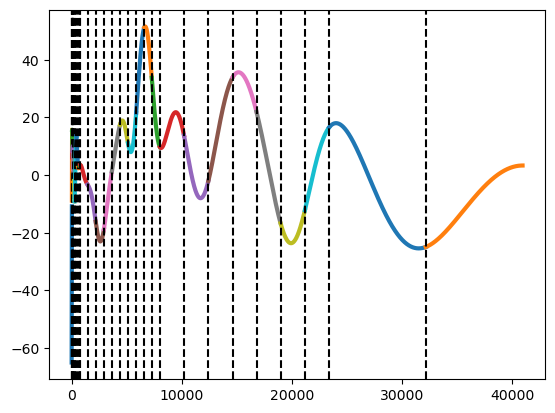

In [29]:
#print correction term epsilon
for k in range(len(t)-1):
    plt.plot(range(t[k],t[k+1],1),[epsilon(x,t,i) for i in range(t[k],t[k+1],1)],lw=3)
    #plot dotted vertical lines at t[k]
    plt.axvline(x=t[k], color='k', linestyle='--')

In [30]:
epsilon_values = [epsilon(x, t, i) for i, _ in enumerate(forecast["yhat"])]
forecast["corrected"] = forecast["yhat"] + epsilon_values

fig = plot_forecast_forwards(cutoff_ts, forecast, forwards)

# Add intial as a dashed red line
fig.add_trace(go.Scatter(
    x=forecast["timestamp"],
    y=forecast["corrected"],
    mode='lines',
    name='PFC',
    line=dict(color='red')
))

# Add the correction area as a transparent red fill
fig.add_trace(go.Scatter(
    x=pd.concat([forecast["timestamp"], forecast["timestamp"][::-1]]),
    y=pd.concat([initial_yhat, forecast["corrected"][::-1]]),
    fill='toself',
    fillcolor='rgba(255, 0, 0, 0.2)',  # Transparent red
    line=dict(color='rgba(255, 0, 0, 0)'),
    name='arbitrage correction \u03b5(t)'
))


In [31]:
check_arbitragefree(forecast,forwards,verbose=True)


Arbitrage amount for forward 2024-05-02 00:00:00+02:00 2024-05-03 00:00:00+02:00 : 0.0
Arbitrage amount for forward 2024-05-03 00:00:00+02:00 2024-05-04 00:00:00+02:00 : 0.0
Arbitrage amount for forward 2024-05-04 00:00:00+02:00 2024-05-05 00:00:00+02:00 : 2.842170943040401e-14
Arbitrage amount for forward 2024-05-05 00:00:00+02:00 2024-05-06 00:00:00+02:00 : 7.815970093361102e-14
Arbitrage amount for forward 2024-05-06 00:00:00+02:00 2024-05-07 00:00:00+02:00 : 8.526512829121202e-13
Arbitrage amount for forward 2024-05-06 00:00:00+02:00 2024-05-13 00:00:00+02:00 : 2.7000623958883807e-13
Arbitrage amount for forward 2024-05-07 00:00:00+02:00 2024-05-08 00:00:00+02:00 : 3.282707439211663e-12
Arbitrage amount for forward 2024-05-08 00:00:00+02:00 2024-05-09 00:00:00+02:00 : 2.6716406864579767e-12
Arbitrage amount for forward 2024-05-11 00:00:00+02:00 2024-05-13 00:00:00+02:00 : 5.471179065352771e-13
Arbitrage amount for forward 2024-05-13 00:00:00+02:00 2024-05-20 00:00:00+02:00 : 5.9685

True